<a href="https://colab.research.google.com/github/MELAI-1/MY-PROJECT/blob/main/public_Health/Federated_Learning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import os
import torch
import numpy as np
import pandas as pd
import torchvision.models as models
import torchvision.transforms as trns
from torchvision.datasets import ImageFolder
from torchvision.transforms import ToTensor
from torch.utils.data import random_split, DataLoader, Dataset
import matplotlib.pyplot as plt
from PIL import Image


In [ ]:
%matplotlib inline
plt.rcParams['figure.figsize'] = [8, 10]

## Map images to their location

In [ ]:
file_map = dict()
for i in range(12):
    path = r'C:\Stuff\VScode\Workspace\Notebooks\DH_FederatedLearning\archive\images_' + ('00' if i < 9 else '0') + str(i + 1) + '\images'
    for f in os.listdir(path):
        if os.path.isfile(os.path.join(path, f)) and f[-4:] == '.png':
            file_map[f] = os.path.join(path, f)

In [ ]:
df = pd.read_csv(r'C:\Stuff\VScode\Workspace\Notebooks\DH_FederatedLearning\archive\Data_Entry_2017.csv')
df.head(10)

,Image Index,Finding Labels,Follow-up #,Patient ID,Patient Age,Patient Gender,View Position,OriginalImage[Width,Height],OriginalImagePixelSpacing[x,y],Unnamed: 11
0,00000001_000.png,Cardiomegaly,0,1,58,M,PA,2682,2749,0.143,0.143,NaN
1,00000001_001.png,Cardiomegaly|Emphysema,1,1,58,M,PA,2894,2729,0.143,0.143,NaN
2,00000001_002.png,Cardiomegaly|Effusion,2,1,58,M,PA,2500,2048,0.168,0.168,NaN
3,00000002_000.png,No Finding,0,2,81,M,PA,2500,2048,0.171,0.171,NaN
4,00000003_000.png,Hernia,0,3,81,F,PA,2582,2991,0.143,0.143,NaN
5,00000003_001.png,Hernia,1,3,74,F,PA,2500,2048,0.168,0.168,NaN
6,00000003_002.png,Hernia,2,3,75,F,PA,2048,2500,0.168,0.168,NaN
7,00000003_003.png,Hernia|Infiltration,3,3,76,F,PA,2698,2991,0.143,0.143,NaN
8,00000003_004.png,Hernia,4,3,77,F,PA,2500,2048,0.168,0.168,NaN
9,00000003_005.png,Hernia,5,3,78,F,PA,2686,2991,0.143,0.143,NaN


In [ ]:
df['Image Index'][0][:8]

'00000001'

In [ ]:
n=0.7

In [ ]:
k=int(30805*n)

In [ ]:
df["split"]=[0]*len(df["Image Index"])

In [ ]:
df["split"]

0         0
1         0
2         0
3         0
4         0
         ..
112115    0
112116    0
112117    0
112118    0
112119    0
Name: split, Length: 112120, dtype: int64

In [ ]:
for st in range(len(df['Image Index'])):
    if int(df["Image Index"][st][:8])<k:
        df["split"][st]=1

C:\Users\tsule\AppData\Local\Temp\ipykernel_14948\2285489620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["split"][st]=1
C:\Users\tsule\AppData\Local\Temp\ipykernel_14948\2285489620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["split"][st]=1
C:\Users\tsule\AppData\Local\Temp\ipykernel_14948\2285489620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["split"][st]=1
C:\Users\tsule\AppData\Local\Temp\ipykernel_14

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 112120 entries, 0 to 112119
Data columns (total 13 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   Image Index                  112120 non-null  object 
 1   Finding Labels               112120 non-null  object 
 2   Follow-up #                  112120 non-null  int64  
 3   Patient ID                   112120 non-null  int64  
 4   Patient Age                  112120 non-null  int64  
 5   Patient Gender               112120 non-null  object 
 6   View Position                112120 non-null  object 
 7   OriginalImage[Width          112120 non-null  int64  
 8   Height]                      112120 non-null  int64  
 9   OriginalImagePixelSpacing[x  112120 non-null  float64
 10  y]                           112120 non-null  float64
 11  Unnamed: 11                  0 non-null       float64
 12  split                        112120 non-null  int64  
dtyp

In [ ]:
def showImage(pil):
    plt.imshow(np.array(pil) / 255)

In [ ]:
def loadImage(path):
    return Image.open(path).convert('RGB')

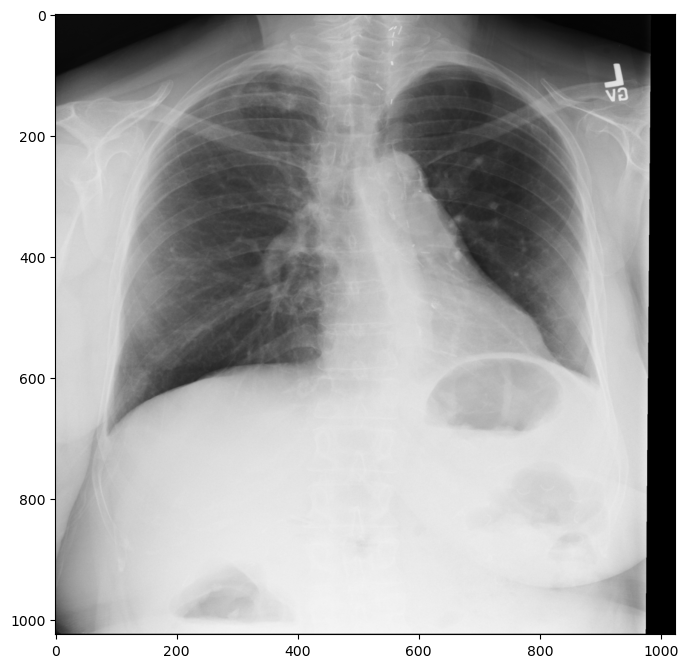

In [ ]:
showImage(loadImage(file_map[list(file_map.keys())[100]]))

In [ ]:
classes = [
    'Atelectasis',
    'Consolidation',
    'Infiltration',
    'Pneumothorax',
    'Edema',
    'Emphysema',
    'Fibrosis',
    'Effusion',
    'Pneumonia',
    'Pleural_thickening',
    'Cardiomegaly',
    'Nodule',
    'Mass',
    'Hernia',
    'No Finding'
]

In [ ]:
class ImageDataset(Dataset):
    def __init__(self, data, transforms):
        self.image_paths = [file_map[f] for f in data[0]]
        self.labels = data[1]
        self.transforms = transforms
        self.data=data

    def __len__(self):
        return len(self.data[0])

    def __getitem__(self, idx):
        image = self.transforms(loadImage(self.image_paths[idx]))
        target = torch.tensor([int(cls in self.labels[idx]) for cls in classes], dtype=torch.float32)
        return [image, target]

In [ ]:
lim=0
for i in range(len(df["split"])):
    if df["split"][i]==0:
        lim=i
        break

In [ ]:
df.iloc[:lim, 0]

0        00000001_000.png
1        00000001_001.png
2        00000001_002.png
3        00000002_000.png
4        00000003_000.png
               ...       
87300    00021559_000.png
87301    00021560_000.png
87302    00021561_000.png
87303    00021562_000.png
87304    00021562_001.png
Name: Image Index, Length: 87305, dtype: object

In [ ]:
val = len(df['Image Index']) - lim

val = int(val/2)
lim = int(lim/2)

In [ ]:
limc = int(lim/2)
limc

21826

In [ ]:
data1 = (df.iloc[:lim, 0], [df.iloc[i, 1].split('|') for i in range(lim)])
data2 = (df.iloc[lim:lim+val, 0], [df.iloc[lim + i, 1].split('|') for i in range(val)])

datac1 = (df.iloc[:limc, 0], [df.iloc[i, 1].split('|') for i in range(limc)])
datac2 = (df.iloc[limc:lim, 0], [df.iloc[limc + i, 1].split('|') for i in range(limc)])

In [ ]:
len(data1[0])

43652

In [ ]:
train_dataset = ImageDataset(data1, trns.Compose([
    trns.Resize((240, 240)),
    trns.ToTensor(),
    trns.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225],inplace=True)
]))

test_dataset = ImageDataset(data2, trns.Compose([
    trns.Resize((240, 240)),
    trns.ToTensor(),
    trns.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225],inplace=True)
]))

In [ ]:
len(test_dataset)

12407

In [ ]:
print(test_dataset)

In [ ]:
import pywt
import pywt.data
import torch
from pywt import dwt2, idwt2

In [ ]:
train_dataset[1]

[tensor([[[ 1.3755,  1.3584,  1.3242,  ...,  1.2385,  1.2557,  1.1700],
          [ 1.3584,  1.3413,  1.2728,  ...,  1.1700,  1.2043,  1.1015],
          [ 1.3584,  1.3070,  1.2557,  ...,  1.1015,  1.1358,  1.0331],
          ...,
          [-0.8849, -1.5185, -1.8439,  ..., -1.9638, -2.0837, -2.1179],
          [-0.8678, -1.5185, -1.8439,  ..., -1.9809, -2.0837, -2.1179],
          [-0.8678, -1.5185, -1.8439,  ..., -1.9809, -2.0837, -2.1179]],
 
         [[ 1.5357,  1.5182,  1.4832,  ...,  1.3957,  1.4132,  1.3256],
          [ 1.5182,  1.5007,  1.4307,  ...,  1.3256,  1.3606,  1.2556],
          [ 1.5182,  1.4657,  1.4132,  ...,  1.2556,  1.2906,  1.1856],
          ...,
          [-0.7752, -1.4230, -1.7556,  ..., -1.8782, -2.0007, -2.0357],
          [-0.7577, -1.4230, -1.7556,  ..., -1.8957, -2.0007, -2.0357],
          [-0.7577, -1.4230, -1.7556,  ..., -1.8957, -2.0007, -2.0357]],
 
         [[ 1.7511,  1.7337,  1.6988,  ...,  1.6117,  1.6291,  1.5420],
          [ 1.7337,  1.7163,

In [ ]:
def wav(img):
    for i in range(len(img)):
        image=img[i][0].permute((1,2,0))
        image2= 0.2989 * image[:,:,0] + 0.5870 * image[:,:,1] + 0.1140 * image[:,:,2]
        coeffs2 = pywt.dwt2(image2, 'haar')
        cA, (cH, cV, cD) = coeffs2
        cS=torch.tensor([cA])
        img[i][0]=(cS,img[i][1])
        print(cS.shape)
        print(i)


In [ ]:
wav(train_dataset)
wav(test_dataset)
# plt.imshow(cA))

torch.Size([1, 120, 120])
0
torch.Size([1, 120, 120])
1
torch.Size([1, 120, 120])
2
torch.Size([1, 120, 120])
3
torch.Size([1, 120, 120])
4
torch.Size([1, 120, 120])
5
torch.Size([1, 120, 120])
6
torch.Size([1, 120, 120])
7
torch.Size([1, 120, 120])
8
torch.Size([1, 120, 120])
9
torch.Size([1, 120, 120])
10
torch.Size([1, 120, 120])
11
torch.Size([1, 120, 120])
12
torch.Size([1, 120, 120])
13
torch.Size([1, 120, 120])
14
torch.Size([1, 120, 120])
15
torch.Size([1, 120, 120])
16
torch.Size([1, 120, 120])
17
torch.Size([1, 120, 120])
18
torch.Size([1, 120, 120])
19
torch.Size([1, 120, 120])
20


torch.Size([1, 120, 120])
21
torch.Size([1, 120, 120])
22
torch.Size([1, 120, 120])
23
torch.Size([1, 120, 120])
24
torch.Size([1, 120, 120])
25
torch.Size([1, 120, 120])
26
torch.Size([1, 120, 120])
27
torch.Size([1, 120, 120])
28
torch.Size([1, 120, 120])
29
torch.Size([1, 120, 120])
30
torch.Size([1, 120, 120])
31
torch.Size([1, 120, 120])
32
torch.Size([1, 120, 120])
33
torch.Size([1, 120, 120])
34
torch.Size([1, 120, 120])
35
torch.Size([1, 120, 120])
36
torch.Size([1, 120, 120])
37
torch.Size([1, 120, 120])
38
torch.Size([1, 120, 120])
39
torch.Size([1, 120, 120])
40
torch.Size([1, 120, 120])
41
torch.Size([1, 120, 120])
42
torch.Size([1, 120, 120])
43
torch.Size([1, 120, 120])
44
torch.Size([1, 120, 120])
45
torch.Size([1, 120, 120])
46
torch.Size([1, 120, 120])
47
torch.Size([1, 120, 120])
48
torch.Size([1, 120, 120])
49
torch.Size([1, 120, 120])
50
torch.Size([1, 120, 120])
51
torch.Size([1, 120, 120])
52
torch.Size([1, 120, 120])
53
torch.Size([1, 120, 120])
54
torch.Size([1,

In [ ]:
train_dataset

In [ ]:
train_dataset

In [ ]:
train_dataset_size = len(train_dataset.labels)
validation_dataset_size = len(test_dataset.labels)

train_dataset_size, validation_dataset_size

(43652, 12407)

In [ ]:
num_classes = 15
input_shape = (1, 120, 120)

In [ ]:
num_clients = 2
rounds = 2
batch_size = 60
epochs_per_client = 2
learning_rate = 1e-1wa

In [ ]:
resnet34 = models.resnet34(pretrained=True)
resnet34

c:\Users\tsule\anaconda3\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\tsule\anaconda3\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

In [ ]:
def get_device():
    return torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

def to_device(data, device):
    if isinstance(data, (list, tuple)):
        return [to_device(x, device) for x in data]
    return data.to(device, non_blocking=True)

class DeviceDataLoader(DataLoader):
        def __init__(self, dl, device):
            self.dl = dl
            self.device = device

        def __iter__(self):
            for batch in self.dl:
                yield to_device(batch, self.device)

        def __len__(self):
            return len(self.dl)

device = get_device()

In [ ]:
class FederatedNet(torch.nn.Module):
    def __init__(self):
        super().__init__()
        self.network = models.resnet34(pretrained=True)
        self.network.fc = torch.nn.Linear(self.network.fc.in_features, num_classes)
        self.track_layers = {
            'layer4':  self.network.layer4,
            'linear': self.network.fc
        }
        self.freeze()

    def freeze(self):
        for param in self.network.parameters():
            param.requires_grad = False
        for layer_name in self.track_layers:
            for param in self.track_layers[layer_name].parameters():
                param.requires_grad = True

    def forward(self, x_batch):
        out = torch.sigmoid(self.network(x_batch))
        return out

    def get_track_layers(self):
        return self.track_layers

    def apply_parameters(self, parameters_dict):
        with torch.no_grad():
            for layer_name in parameters_dict:
                layer_params = list(self.track_layers[layer_name].parameters())
                for i in range(len(layer_params)):
                    layer_params[i].data = (layer_params[i].data + (parameters_dict[layer_name][i] -
                                                layer_params[i].data))

    def get_parameters(self):
        parameters_dict = dict()
        for layer_name in self.track_layers:
            parameters_dict[layer_name] = [param.data.clone().detach() for param in self.track_layers
                                                [layer_name].parameters()]
        return parameters_dict

    def batch_accuracy(self, outputs, labels):
        with torch.no_grad():
            return torch.tensor(torch.sum((outputs > 0.5) == labels).item() / len(outputs))

    def _process_batch(self, batch):
        images, labels = batch
        outputs = self(images)
        loss = torch.nn.functional.binary_cross_entropy(outputs, labels)
        accuracy = self.batch_accuracy(outputs, labels)
        return (loss, accuracy)

    def fit(self, dataset, epochs, lr, batch_size=128, opt=torch.optim.SGD):
        self.train()
        dataloader = DeviceDataLoader(DataLoader(dataset, batch_size, shuffle=True), device)
        optimizer = opt(self.parameters(), lr)
        history = []
        for epoch in range(epochs):
            losses = []
            accs = []
            for batch in dataloader:
                loss, acc = self._process_batch(batch)
                loss.backward()
                optimizer.step()
                optimizer.zero_grad()
                loss.detach()
                losses.append(loss)
                accs.append(acc)
            avg_loss = torch.stack(losses).mean().item()
            avg_acc = torch.stack(accs).mean().item()
            history.append((avg_loss, avg_acc))
        return history

    def evaluate(self, dataset, batch_size=64):
        self.eval()
        dataloader = DeviceDataLoader(DataLoader(dataset, batch_size), device)
        losses = []
        accs = []
        with torch.no_grad():
            for batch in dataloader:
                loss, acc = self._process_batch(batch)
                losses.append(loss)
                accs.append(acc)
        avg_loss = torch.stack(losses).mean().item()
        avg_acc = torch.stack(accs).mean().item()
        return (avg_loss, avg_acc)
    def evaluate_class(self, dataset, batch_size=64):
        self.eval()
        dataloader = DeviceDataLoader(DataLoader(dataset, batch_size), device)
        losses = []
        accs = []
        with torch.no_grad():
            for batch in dataloader:
                loss, acc = self._process_batch_class(batch)
                losses.append(loss)
                accs.append(acc)
        return (losses, accs)

    def _process_batch_class(self, batch):
        images, labels = batch
        outputs = self(images)
        loss = torch.nn.functional.binary_cross_entropy(outputs, labels)
        accuracy = self.batch_accuracy_class(outputs, labels)
        return (loss, accuracy)

    def batch_accuracy_class(self, outputs, labels):
        """Calculates the batch accuracy for each label separately.

        Args:
            outputs: A tensor of shape (batch_size, num_labels) containing the predicted
            probabilities for each label.
            labels: A tensor of shape (batch_size, num_labels) containing the ground truth
            labels for each label.

        Returns:
            A list of accuracies for each label.
        """

        with torch.no_grad():
            accuracies = []
            for label_index in range(labels.shape[1]):
                # Split the outputs and labels tensors for the current label.
                outputs_label = outputs[:, label_index]
                labels_label = labels[:, label_index]

                # Calculate the accuracy for the current label.
                accuracy = torch.tensor(torch.sum((outputs_label > 0.5) == labels_label).item() / len(outputs_label))

                # Add the accuracy for the current label to the list of accuracies.
                accuracies.append(accuracy)

            return accuracies


In [ ]:
outputs = torch.tensor([0.6, 0.3, 0.7, 0.9])
labels = torch.tensor([1, 0, 1, 1])

correct_predictions = ((outputs > 0.5) == labels)

print(correct_predictions)

tensor([True, True, True, True])


In [ ]:
class Client:
    def __init__(self, client_id, dataset):
        self.client_id = client_id
        self.dataset = dataset

    def get_dataset_size(self):
        return len(self.dataset)

    def get_client_id(self):
        return self.client_id

    def train(self, parameters_dict, return_model_dict=False):
        net = to_device(FederatedNet(), device)
        net.apply_parameters(parameters_dict)
        train_history = net.fit(self.dataset, epochs_per_client, learning_rate, batch_size)
        print(self.client_id + ':')
        for i, res in enumerate(train_history):
            print('Epoch [{}]: Loss = {}, Accuracy = {}'.format(i + 1, round(res[0], 4), round(res[1], 4)))
        return net.get_parameters(), net.state_dict() if return_model_dict else None

In [ ]:
len(datac2[1]+datac1[1]) == len(data1[1])

True

In [ ]:
client1_dataset = ImageDataset(datac1, trns.Compose([
    trns.Resize((240, 240)),
    trns.ToTensor(),
    trns.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225],inplace=True)
]))
client2_dataset = ImageDataset(datac2, trns.Compose([
    trns.Resize((240, 240)),
    trns.ToTensor(),
    trns.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225],inplace=True)
]))

client_datasets = []
client_datasets.append(client1_dataset)
client_datasets.append(client2_dataset)


In [ ]:
client_datasets

In [ ]:
# examples_per_client = train_dataset_size // num_clients
# client_datasets = random_split(train_dataset, [min(i + examples_per_client,
#            train_dataset_size) - i for i in range(0, train_dataset_size, examples_per_client)])
clients = [Client('client_' + str(i), client_datasets[i]) for i in range(num_clients)]

In [ ]:
global_net = to_device(FederatedNet(), device)
history = []

for i in range(rounds):
    print('Start Round {} ...'.format(i + 1))
    curr_parameters = global_net.get_parameters()
    new_parameters = dict([(layer_name, [0 for param in global_net.track_layers[layer_name].parameters()])
                            for layer_name in curr_parameters])
    for j, client in enumerate(clients):
        client_parameters, state_dict = client.train(curr_parameters, (j == len(clients) - 1))
        if j == len(clients) - 1:
            global_net.load_state_dict(state_dict)
            global_net.apply_parameters(client_parameters)
            train_loss, train_acc = global_net.evaluate(train_dataset)
            val_loss, val_acc = global_net.evaluate(test_dataset)
            print('After round {}, train_loss = {}, val_loss = {}, val_acc = {}\n'.format(i + 1, round(train_loss, 4),
                    round(val_loss, 4), round(val_acc, 4)))
            history.append((train_loss, val_loss))

        fraction = client.get_dataset_size() / train_dataset_size
        for layer_name in client_parameters:
            for j in range(len(client_parameters[layer_name])):
                new_parameters[layer_name][j] += fraction * client_parameters[layer_name][j]

    global_net.apply_parameters(new_parameters)

Start Round 1 ...
client_0:
Epoch [1]: Loss = 0.1855, Accuracy = 14.0323
Epoch [2]: Loss = 0.1732, Accuracy = 14.0851
client_1:
Epoch [1]: Loss = 0.1889, Accuracy = 14.0022
Epoch [2]: Loss = 0.1758, Accuracy = 14.0588
After round 1, train_loss = 0.1742, val_loss = 0.1928, val_acc = 13.9649

Start Round 2 ...
client_0:
Epoch [1]: Loss = 0.1711, Accuracy = 14.0893
Epoch [2]: Loss = 0.1638, Accuracy = 14.1108
client_1:
Epoch [1]: Loss = 0.1733, Accuracy = 14.0656
Epoch [2]: Loss = 0.1661, Accuracy = 14.093
After round 2, train_loss = 0.1646, val_loss = 0.1918, val_acc = 13.9633



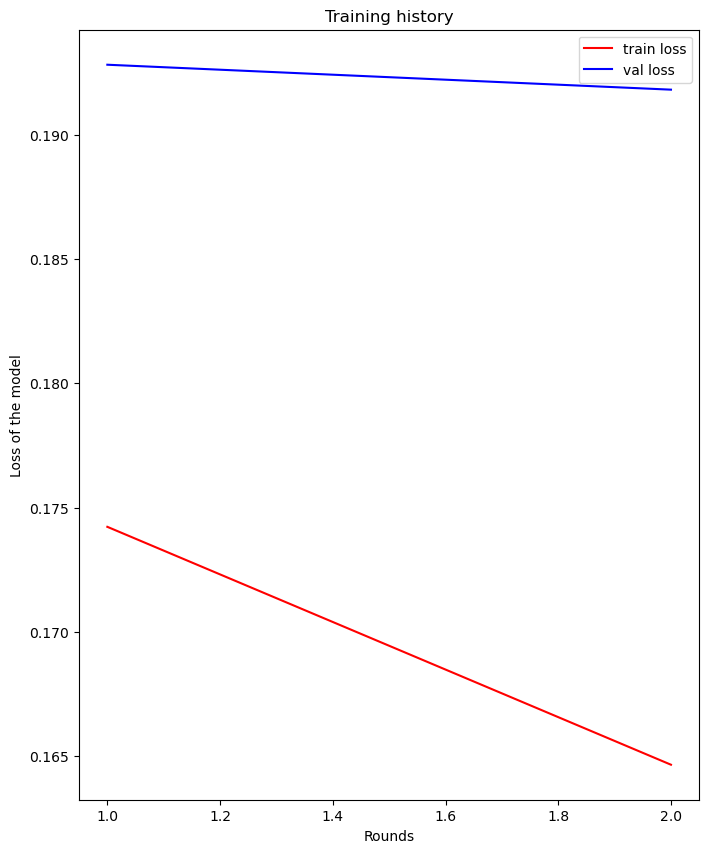

In [ ]:
plt.plot([i + 1 for i in range(len(history))], [history[i][0] for i in range(len(history))], color='r', label='train loss')
plt.plot([i + 1 for i in range(len(history))], [history[i][1] for i in range(len(history))], color='b', label='val loss')
plt.title('Training history')
plt.xlabel('Rounds')
plt.ylabel('Loss of the model')
plt.legend()
plt.show()

In [ ]:
dataloader = DeviceDataLoader(DataLoader(test_dataset, 64), device)
labels = []
outputs = []
for batch in dataloader:
    images, label = batch
    label = label.cpu().numpy()
    outputs.append(global_net(images).cpu().detach().numpy())
    labels.append(label)

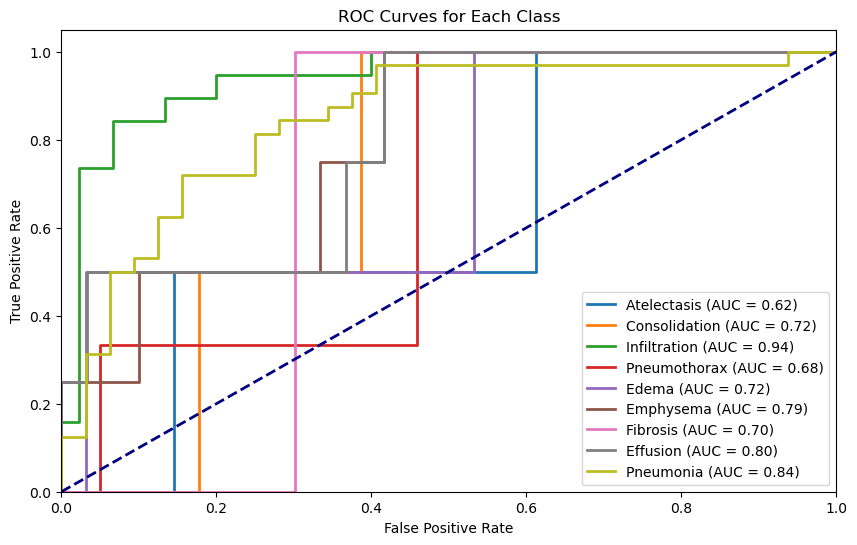

In [ ]:
import torch
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt

# Assuming you have your outputs and labels tensors already

with torch.no_grad():
    fpr_list = []
    tpr_list = []
    roc_auc_list = []

    for label_index in range(labels[0].shape[1]):
        outputs_label = outputs[0][:, label_index]
        labels_label = labels[0][:, label_index]

        if labels[0][:, label_index].sum() > 0:
            fpr, tpr, _ = roc_curve(labels_label, outputs_label)
            roc_auc = auc(fpr, tpr)

            fpr_list.append(fpr)
            tpr_list.append(tpr)
            roc_auc_list.append(roc_auc)

    # Plot ROC curves
    plt.figure(figsize=(10, 6))
    for i in range(len(fpr_list)):
        plt.plot(fpr_list[i], tpr_list[i], lw=2, label=f'{classes[i]} (AUC = {roc_auc_list[i]:.2f})')

    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('ROC Curves for Each Class')
    plt.legend(loc='lower right')
    plt.show()
